# PART A - Autoencoder
In this part we will construct and compare different autoencoder models for the image colourization task.

## Part 2 Image Colourization as Regression

There are many ways to frame the problem of image colourization as a machine learning problem. One naive approach is to frame it as a regression problem, where we build a model to predict the RGB intensities at each pixel given the greyscale input. In this case, the outputs are continuous, and so squared error can be used to train the model.

In this section, I will be the training neural networks using cloud GPUs.

#### Helper Code

Regression Architecture

In [ ]:
class RegressionCNN(nn.Module):
    def __init__(self, kernel, num_filters):
        # first call parent's initialization function
        super().__init__()
        padding = kernel // 2

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.MaxPool2d(2),)
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.MaxPool2d(2),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU())

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters, 3, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(3),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.finalconv = nn.Conv2d(3, 3, kernel_size=kernel, padding=padding)

    def forward(self, x):
        out = self.downconv1(x)
        out = self.downconv2(out)
        out = self.rfconv(out)
        out = self.upconv1(out)
        out = self.upconv2(out)
        out = self.finalconv(out)
        return out

Training code

In [ ]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): rgb as labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float()
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def train(args, gen=None):

    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)
            # Forward + Backward + Optimize
            optimizer.zero_grad()
            outputs = gen(images)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())

        print(epoch, loss.cpu().detach())
        if args.plot:
          visual(images, labels, outputs, args.gpu, 1)

    return gen

Training visualization code

In [ ]:
# visualize 5 train/test images
def visual(img_grey, img_real, img_fake, gpu = 0, flag_torch = 0):

  if gpu:
    img_grey = img_grey.cpu().detach()
    img_real = img_real.cpu().detach()
    img_fake = img_fake.cpu().detach()

  if flag_torch:
    img_grey = img_grey.numpy()
    img_real = img_real.numpy()
    img_fake = img_fake.numpy()

  if flag_torch == 2:
    img_real = np.transpose(img_real[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()
    img_fake = np.transpose(img_fake[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()

  #correct image structure
  img_grey = np.transpose(img_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
  img_real = np.transpose(img_real[:5, :, :, :], [0, 2, 3, 1])
  img_fake = np.transpose(img_fake[:5, :, :, :], [0, 2, 3, 1])

  for i in range(5):
      ax = plt.subplot(3, 5, i + 1)
      ax.imshow(np.clip(img_grey[i], 0, 1), cmap='gray') #clip to [0,1] to remove warning
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 5)
      ax.imshow(np.clip(img_real[i], 0, 1))
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 10)
      ax.imshow(np.clip(img_fake[i], 0, 1))
      ax.axis("off")
  plt.show()

Main training loop for regression CNN

In [ ]:
#Main training loop for CNN
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

### Part (i)
Describe the model RegressionCNN.

It has 6 convolution layers.
At the first layer, the number of filters equals to 'num_filters' and it is 32 by definition in 'args_dict'. The filter size is 'kernel'*'kernel' and it is 3*3 by definition
in 'args_dict'.
At the second layer, the number of filters equals to 'num_filters'*2 and it is 32*2=64. The filter size is 'kernel'*'kernel' and it is 3*3 by definition
in 'args_dict'.
At the third layer, the number of filters equals to 'num_filters'*2 and it is 32*2=64. The filter size is 'kernel'*'kernel' and it is 3*3 by definition
in 'args_dict'.
At the fourth layer, the number of filters equals to 'num_filters' and it is 32 by definition in 'args_dict'. The filter size is 'kernel'*'kernel' and
it is 3*3 by definition in 'args_dict'.
At the fifth layer, the number of filters equals to 3. The filter size is 'kernel'*'kernel' and it is 3*3 by definition in 'args_dict'.
At the sixth layer, the number of output filters equals to 3. The filter size is 'kernel'*'kernel' and it is 3*3 by definition in 'args_dict'.

### Part (ii)
Run the regression training code (should run without errors). This will generate some images.

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0499)


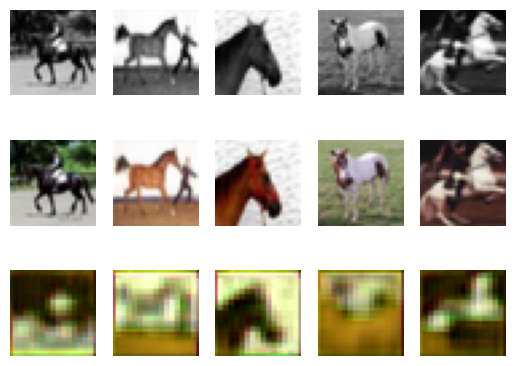

1 tensor(0.0207)


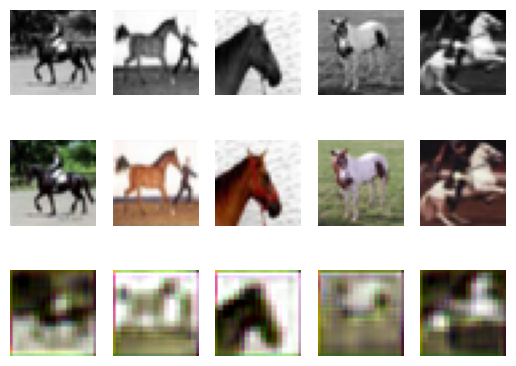

2 tensor(0.0177)


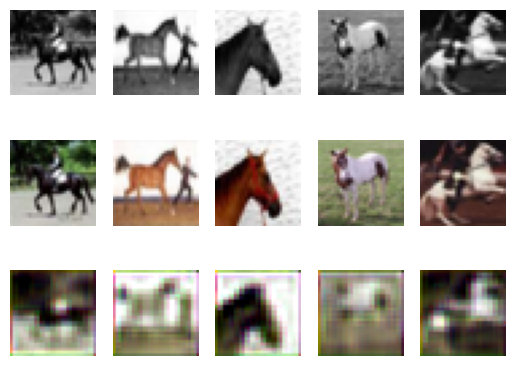

3 tensor(0.0160)


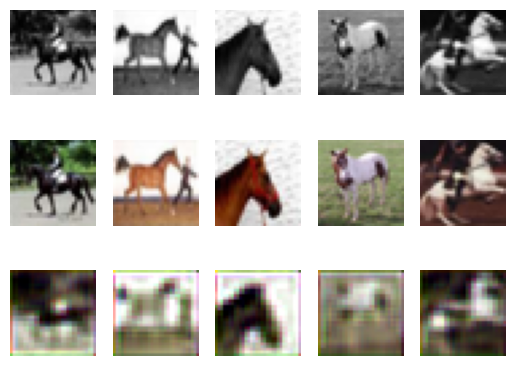

4 tensor(0.0149)


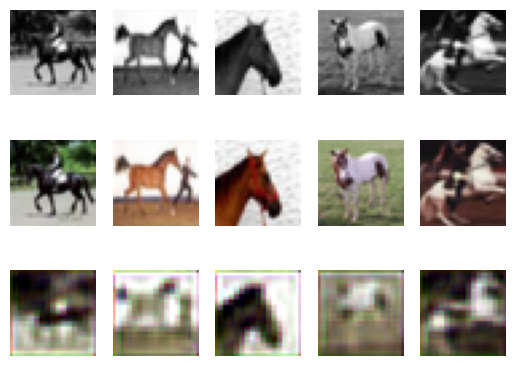

5 tensor(0.0141)


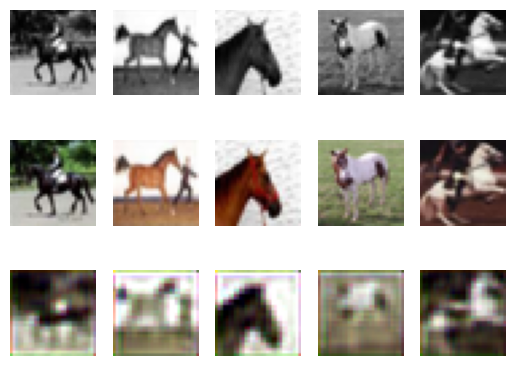

6 tensor(0.0134)


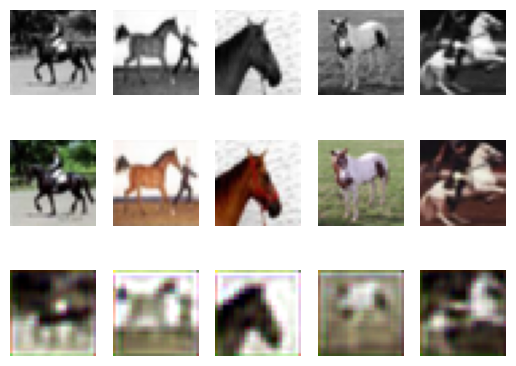

7 tensor(0.0128)


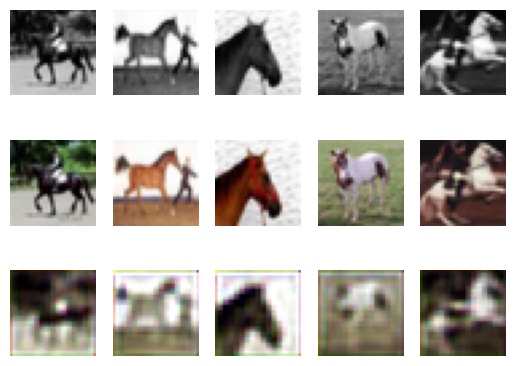

8 tensor(0.0123)


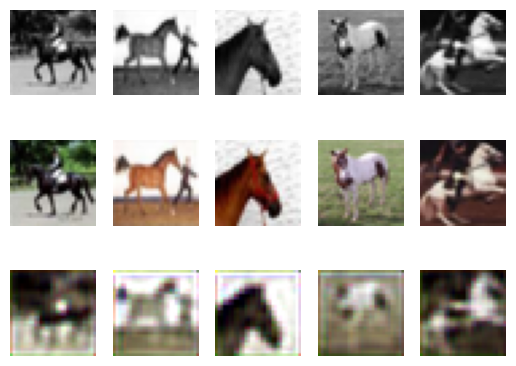

9 tensor(0.0118)


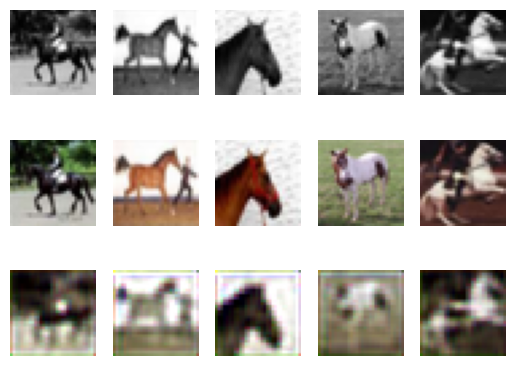

10 tensor(0.0113)


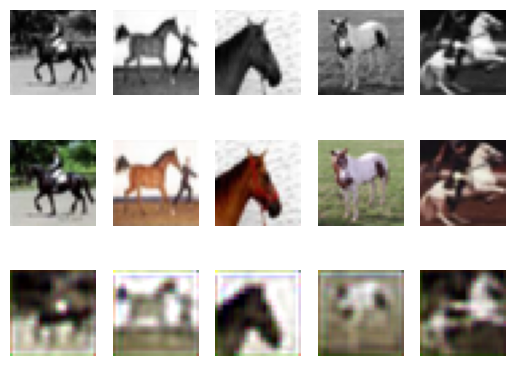

11 tensor(0.0109)


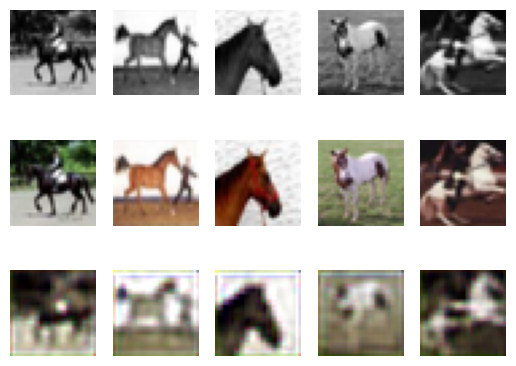

12 tensor(0.0106)


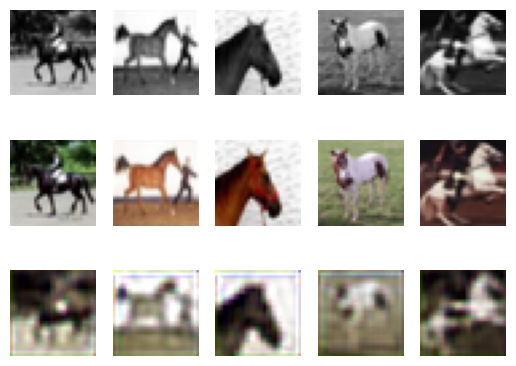

13 tensor(0.0103)


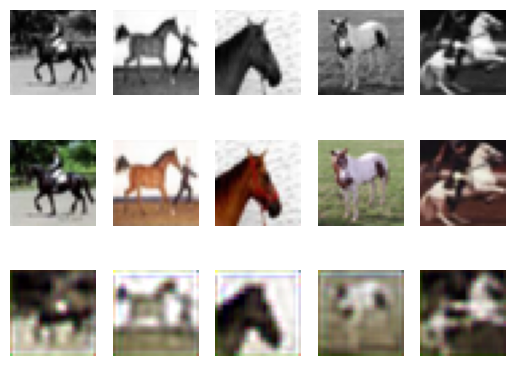

14 tensor(0.0101)


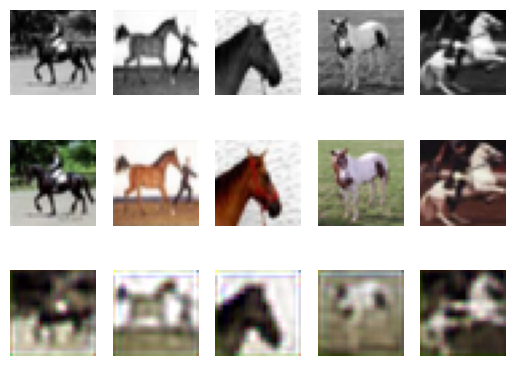

15 tensor(0.0099)


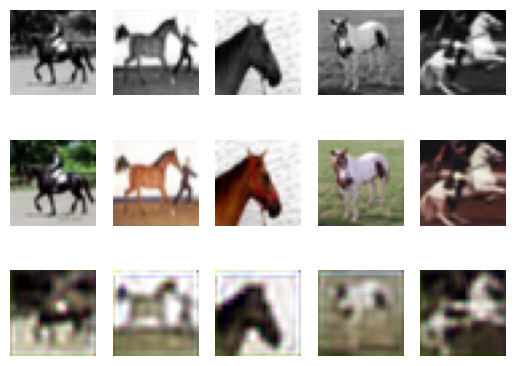

16 tensor(0.0097)


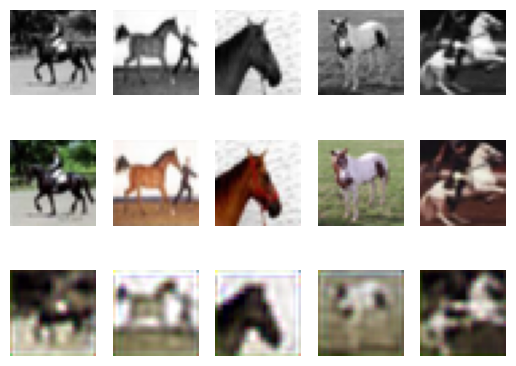

17 tensor(0.0096)


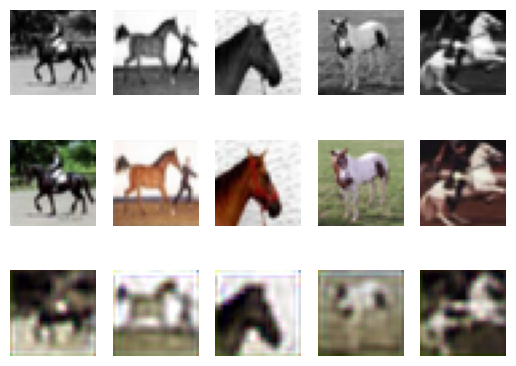

18 tensor(0.0095)


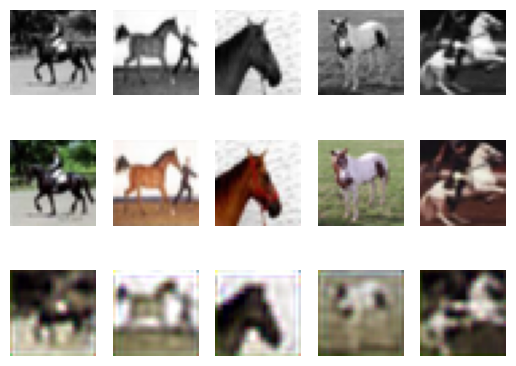

19 tensor(0.0094)


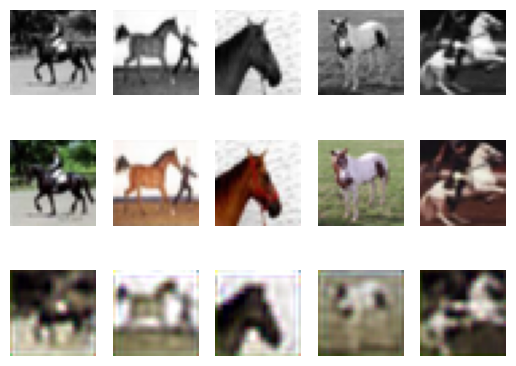

20 tensor(0.0092)


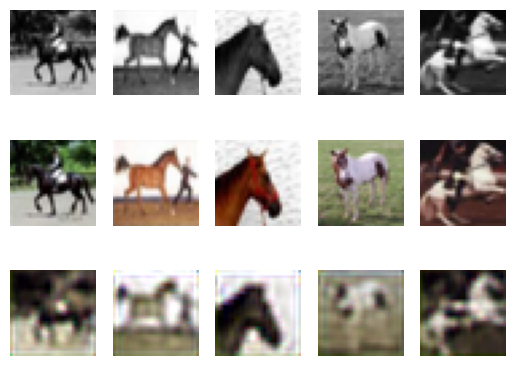

21 tensor(0.0091)


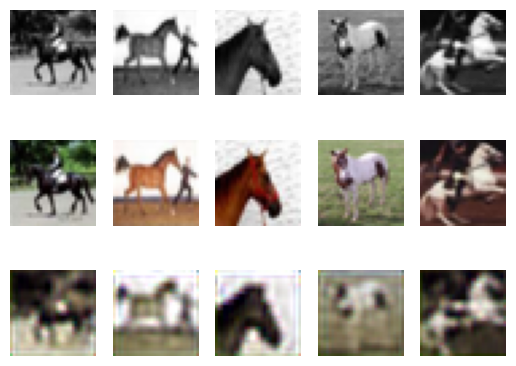

22 tensor(0.0090)


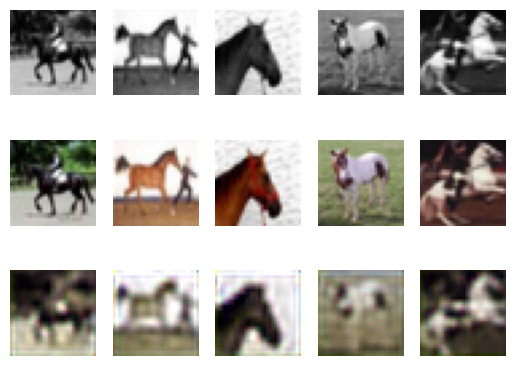

23 tensor(0.0089)


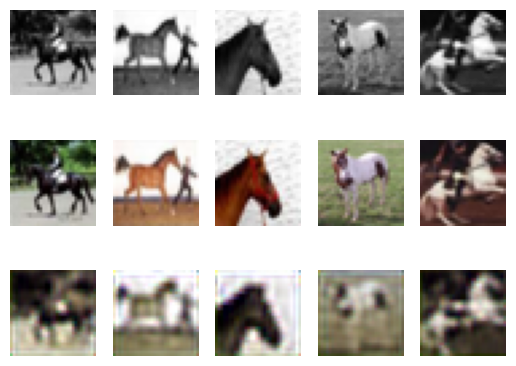

24 tensor(0.0088)


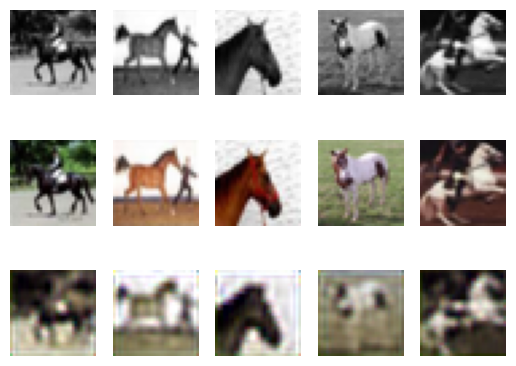

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

In the above given setting, we are training 25 epoch.

### Part (iii)
Re-train a couple of new models using a different number of training epochs. Comment on how the results (output images, training loss) change as we increase or decrease the number of epochs.

In [ ]:
#model 1: epoch = 50
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 100,
    "epochs": 50,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0250)


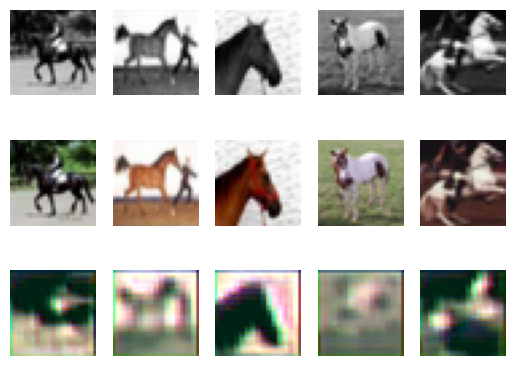

1 tensor(0.0191)


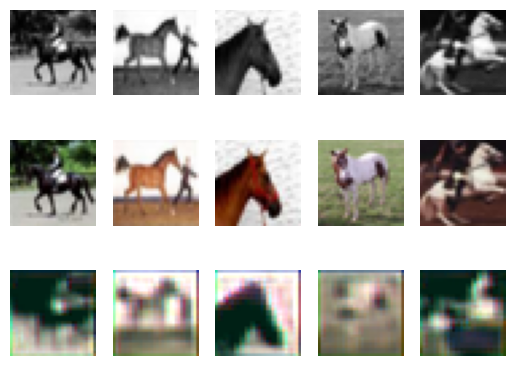

2 tensor(0.0159)


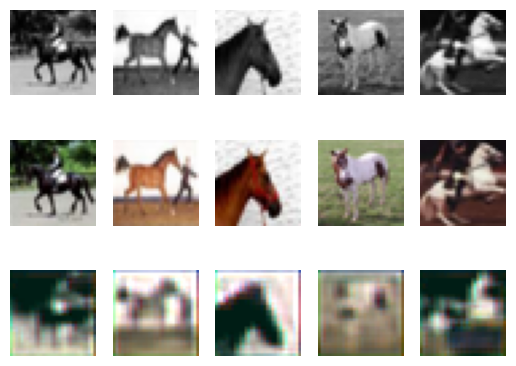

3 tensor(0.0140)


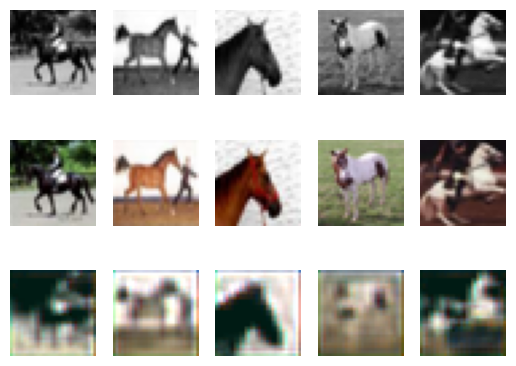

4 tensor(0.0128)


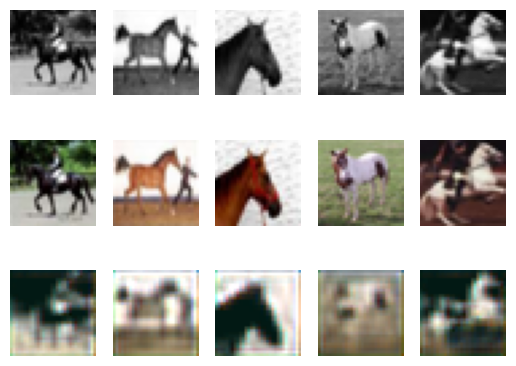

5 tensor(0.0119)


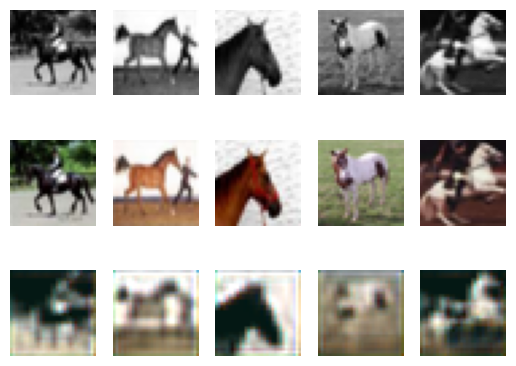

6 tensor(0.0113)


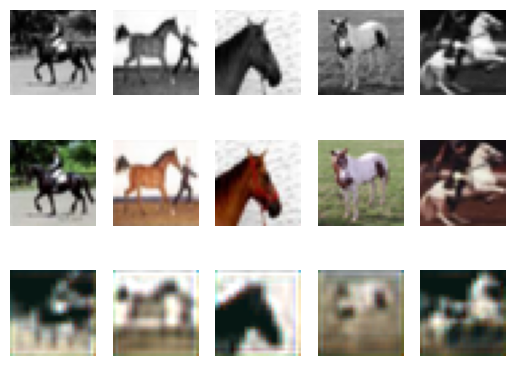

7 tensor(0.0109)


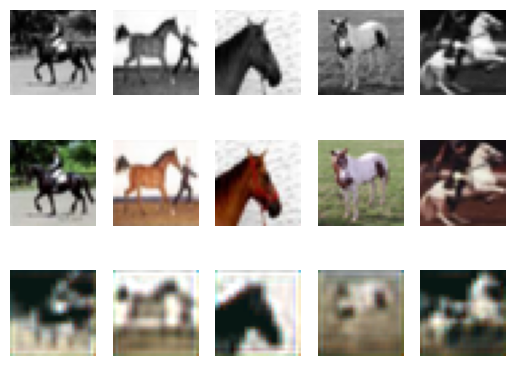

8 tensor(0.0105)


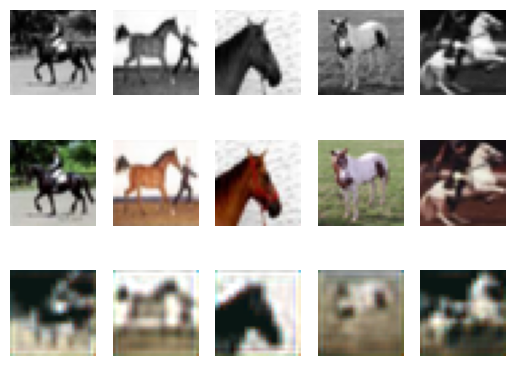

9 tensor(0.0102)


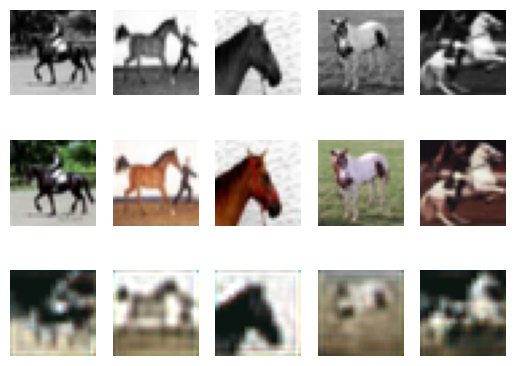

10 tensor(0.0100)


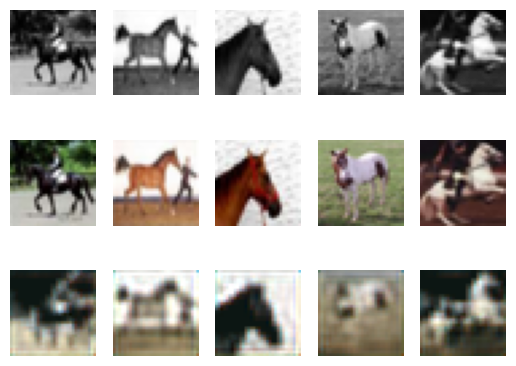

11 tensor(0.0097)


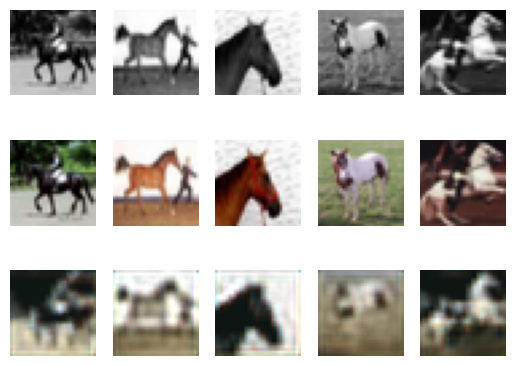

12 tensor(0.0096)


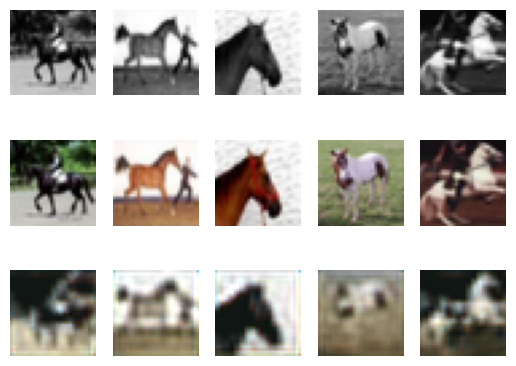

13 tensor(0.0094)


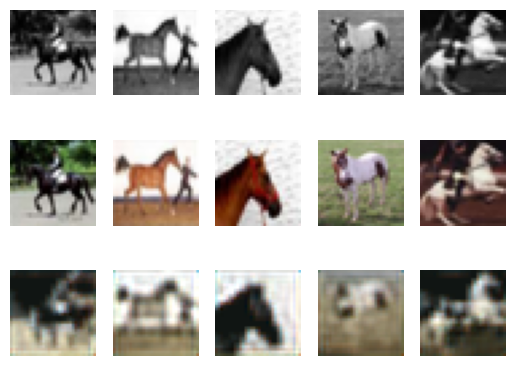

14 tensor(0.0093)


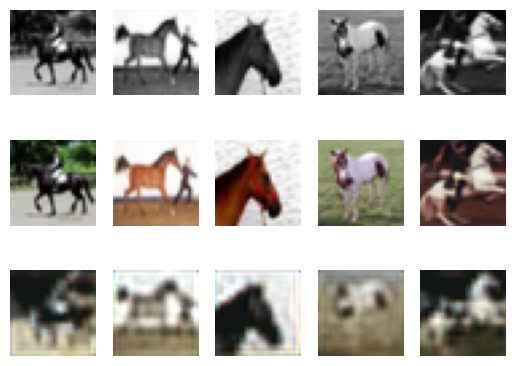

15 tensor(0.0091)


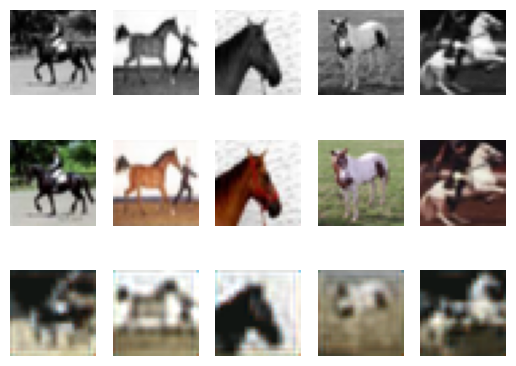

16 tensor(0.0090)


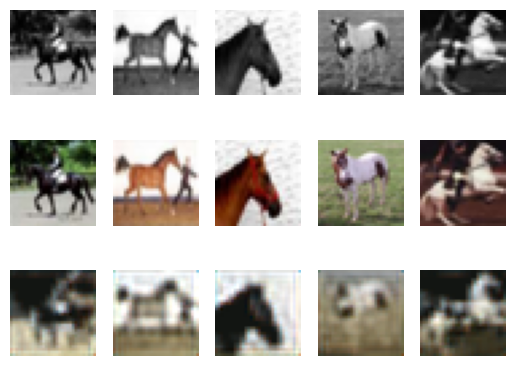

17 tensor(0.0089)


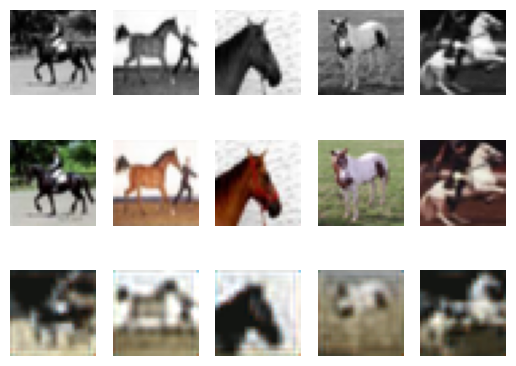

18 tensor(0.0088)


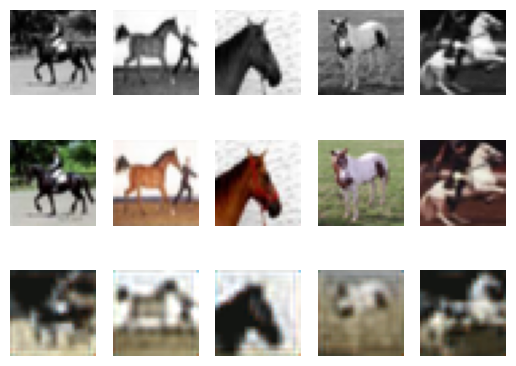

19 tensor(0.0087)


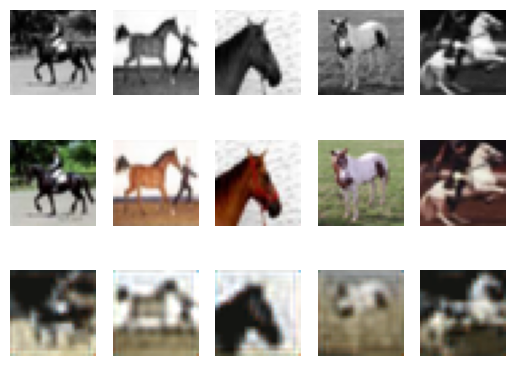

20 tensor(0.0086)


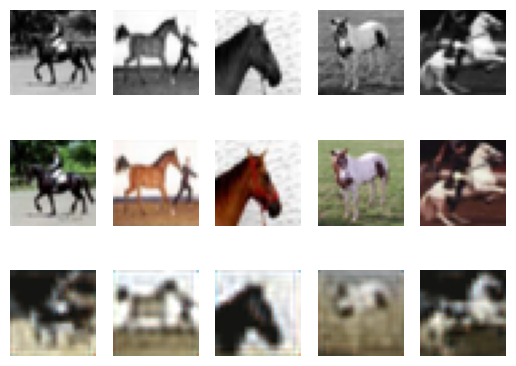

21 tensor(0.0085)


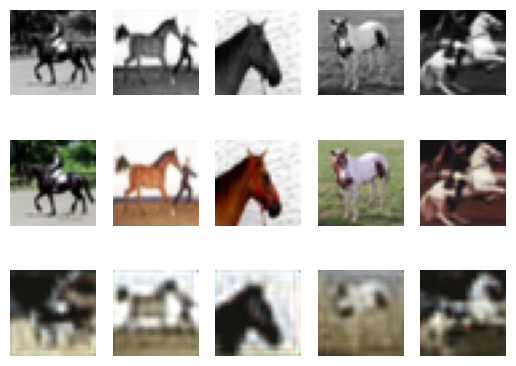

22 tensor(0.0084)


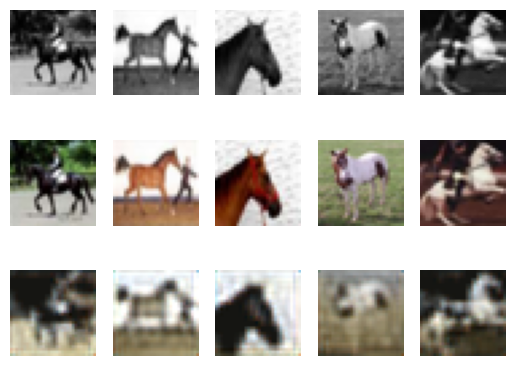

23 tensor(0.0084)


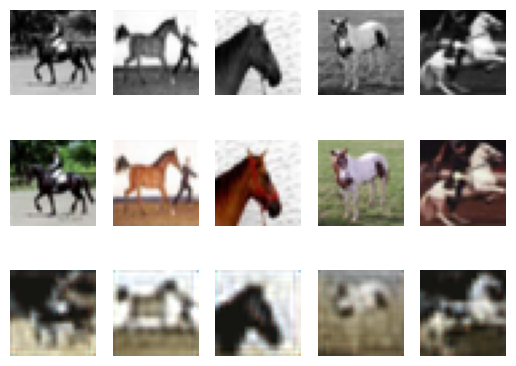

24 tensor(0.0083)


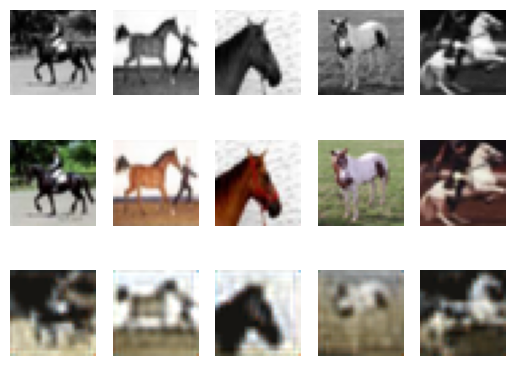

25 tensor(0.0082)


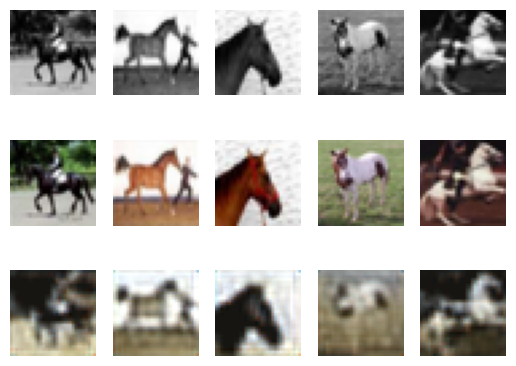

26 tensor(0.0082)


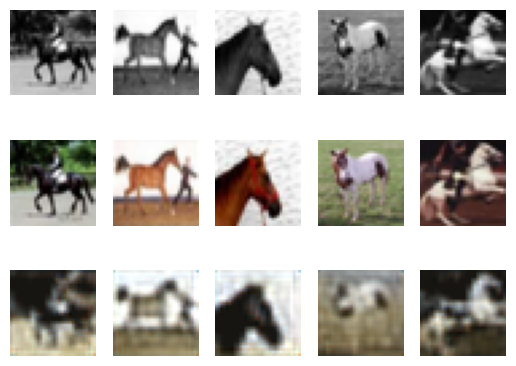

27 tensor(0.0081)


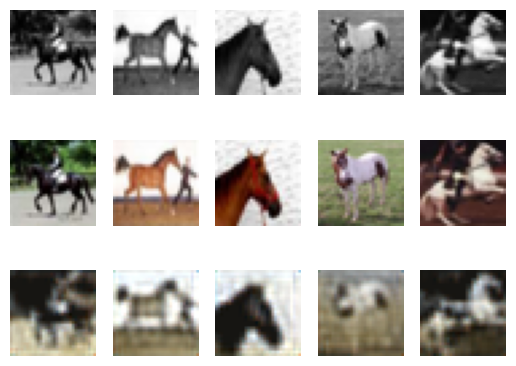

28 tensor(0.0080)


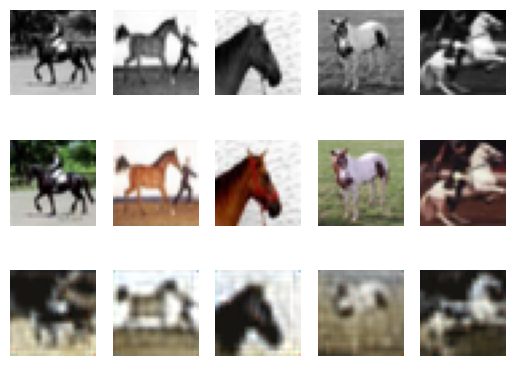

29 tensor(0.0080)


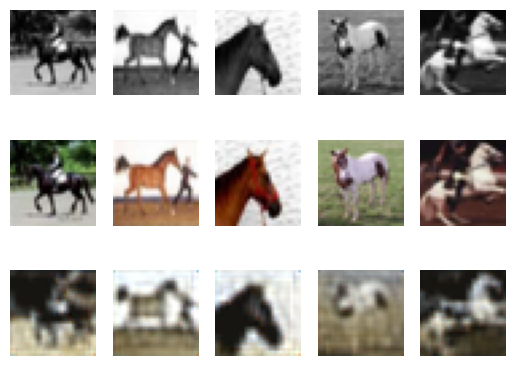

30 tensor(0.0079)


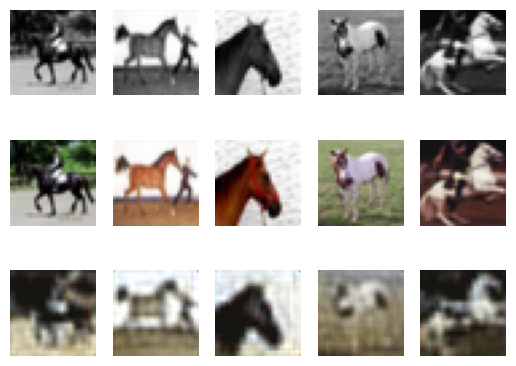

31 tensor(0.0079)


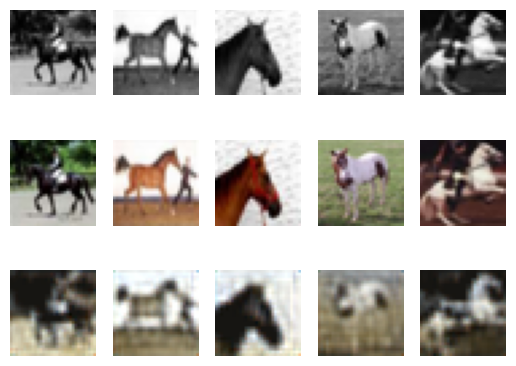

32 tensor(0.0078)


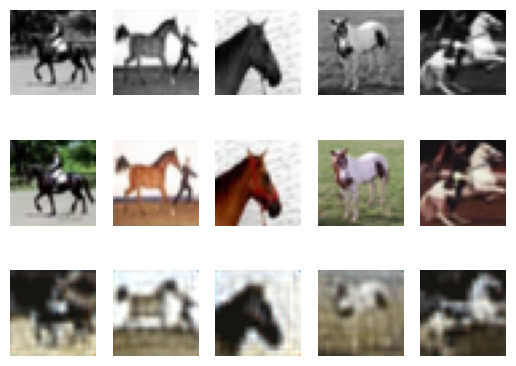

33 tensor(0.0077)


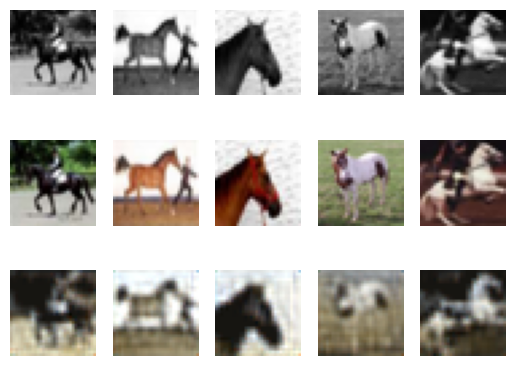

34 tensor(0.0077)


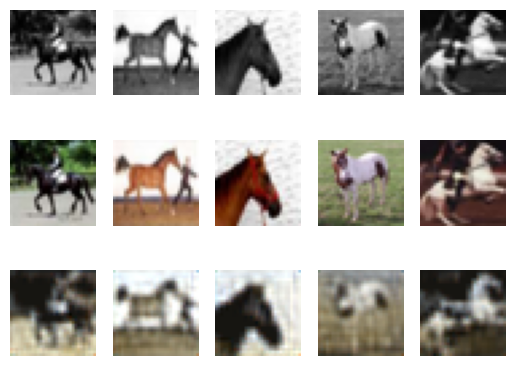

35 tensor(0.0076)


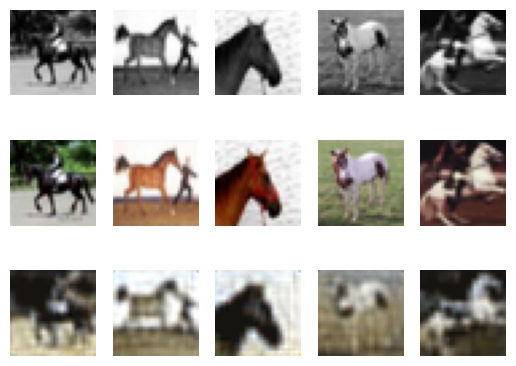

36 tensor(0.0076)


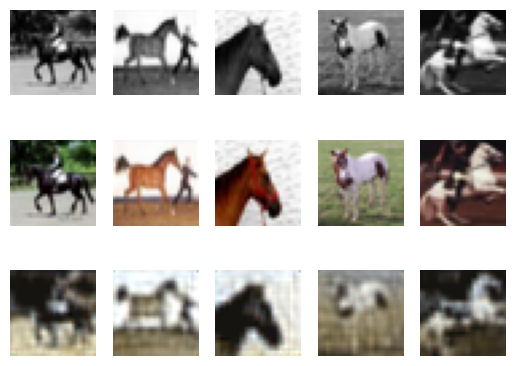

37 tensor(0.0076)


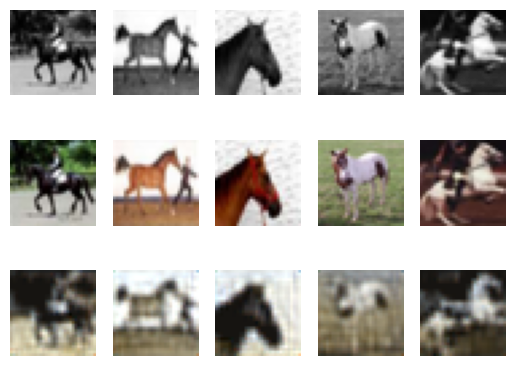

38 tensor(0.0075)


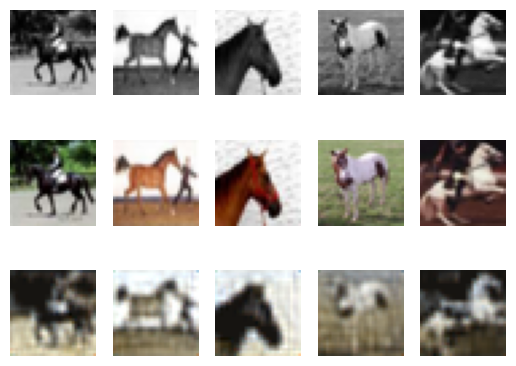

39 tensor(0.0075)


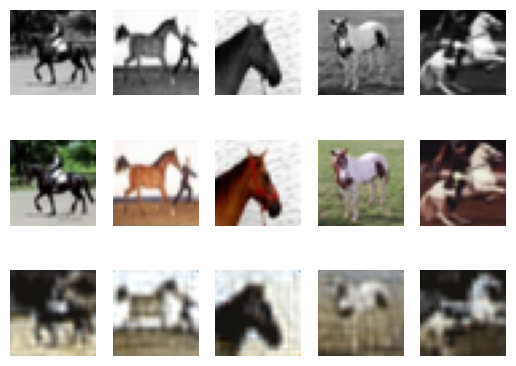

40 tensor(0.0074)


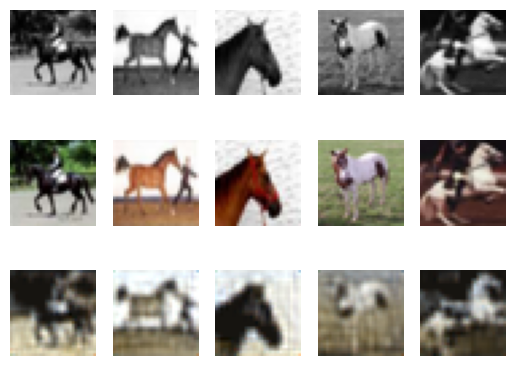

41 tensor(0.0074)


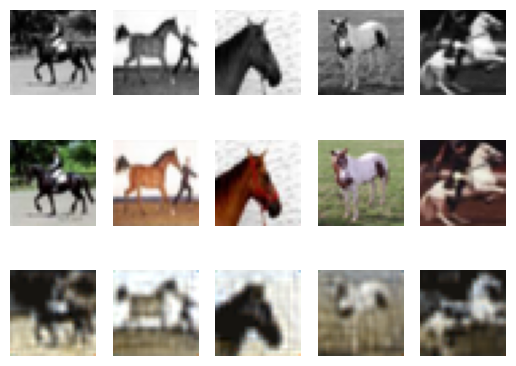

42 tensor(0.0073)


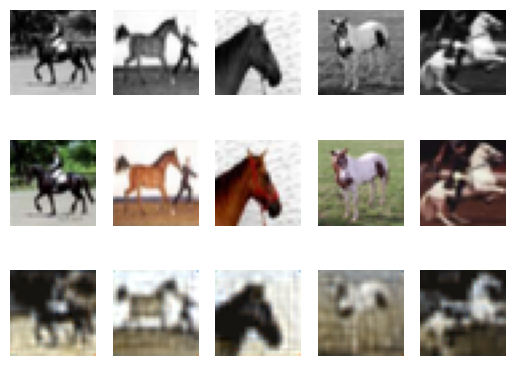

43 tensor(0.0073)


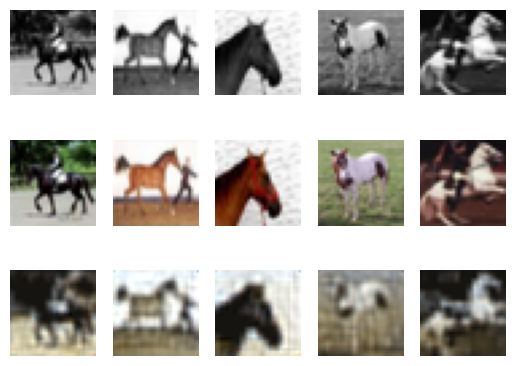

44 tensor(0.0072)


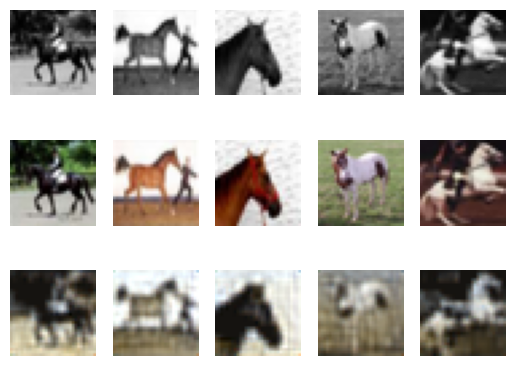

45 tensor(0.0072)


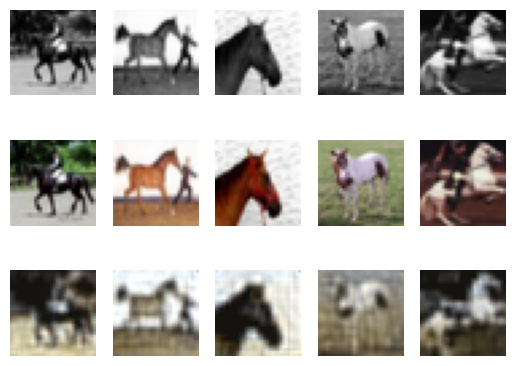

46 tensor(0.0071)


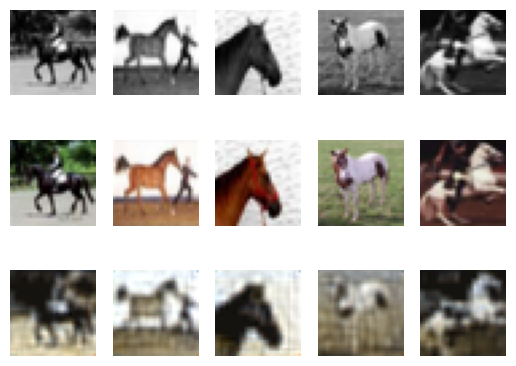

47 tensor(0.0071)


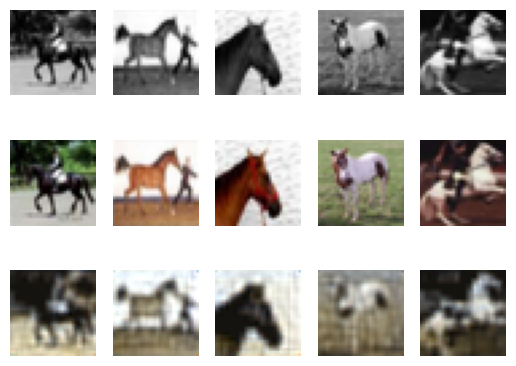

48 tensor(0.0070)


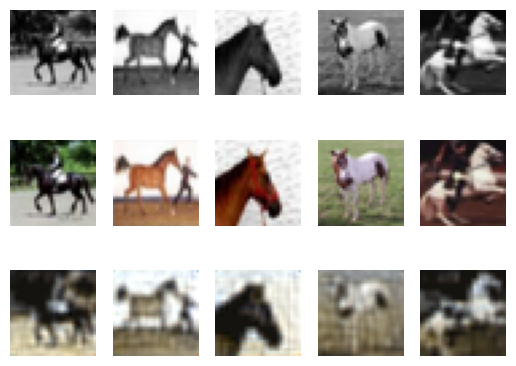

49 tensor(0.0070)


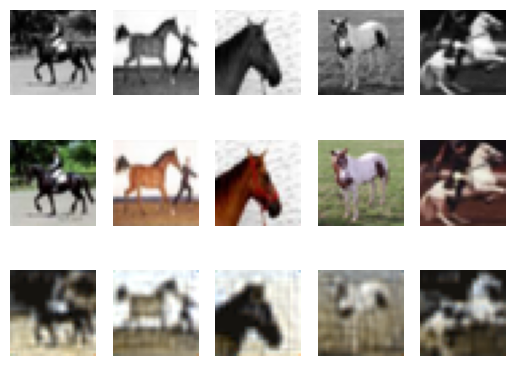

50 tensor(0.0070)


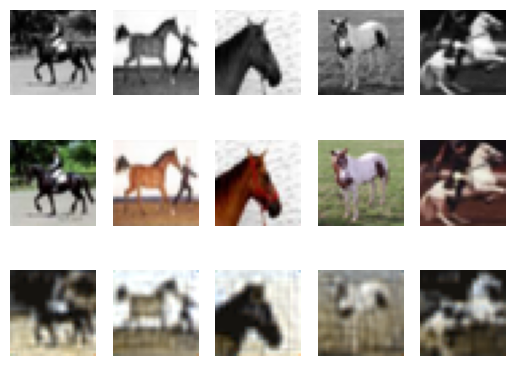

51 tensor(0.0069)


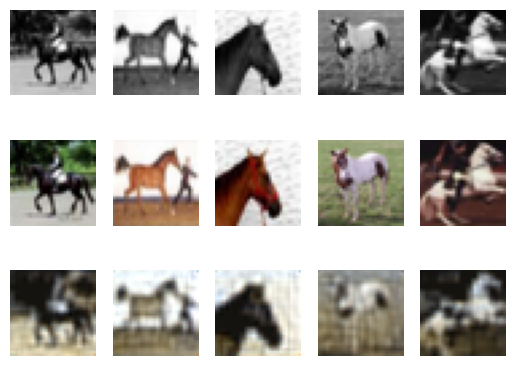

52 tensor(0.0069)


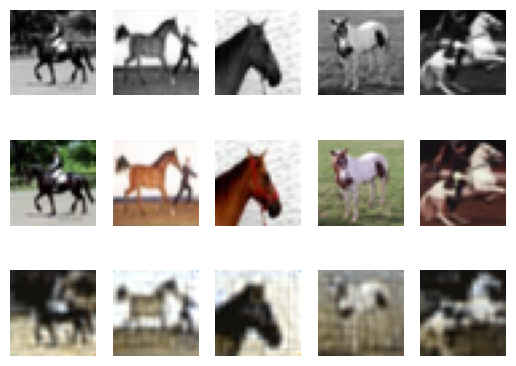

53 tensor(0.0069)


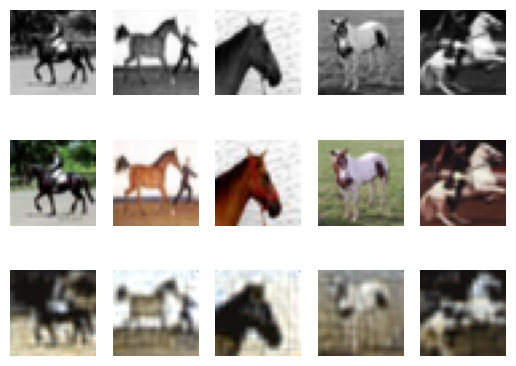

54 tensor(0.0068)


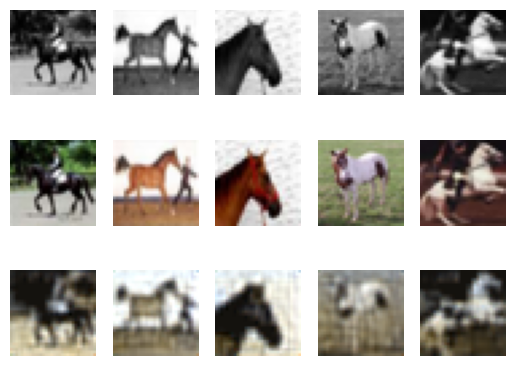

55 tensor(0.0068)


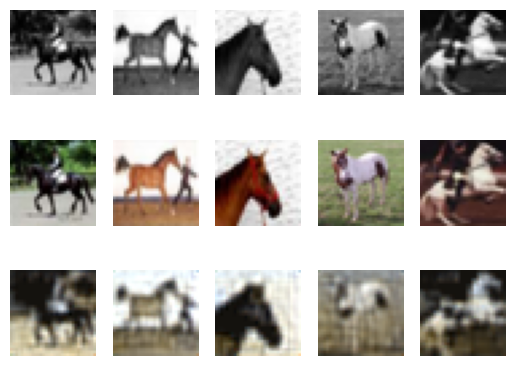

56 tensor(0.0067)


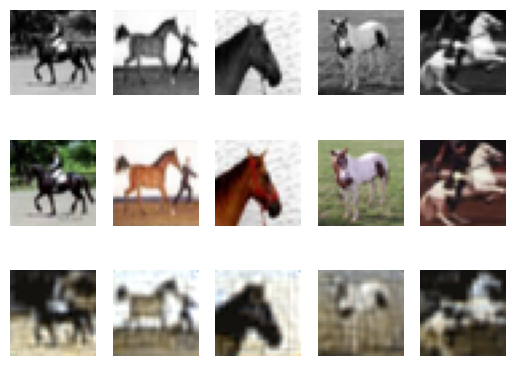

57 tensor(0.0067)


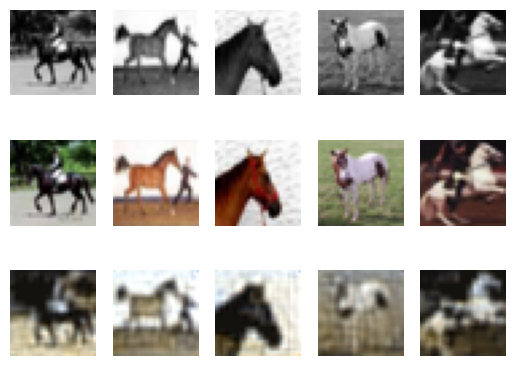

58 tensor(0.0067)


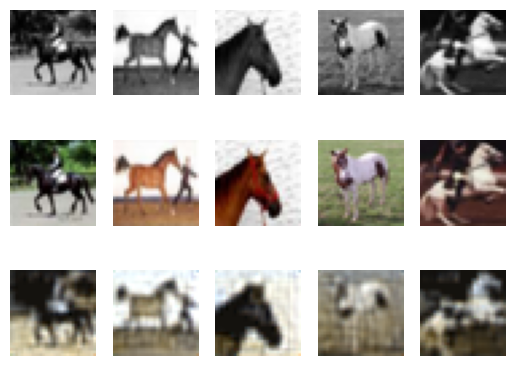

59 tensor(0.0066)


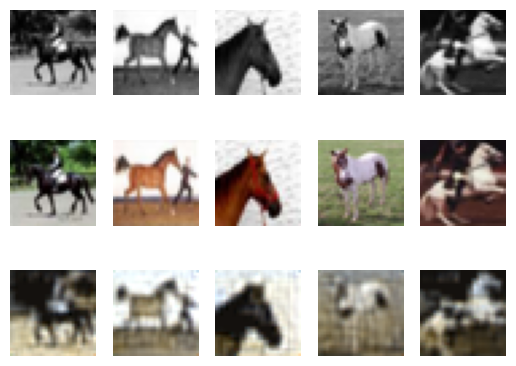

60 tensor(0.0066)


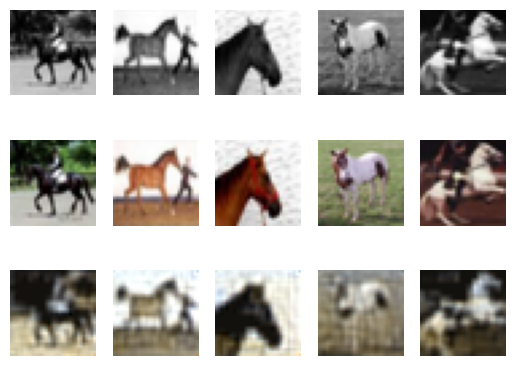

61 tensor(0.0066)


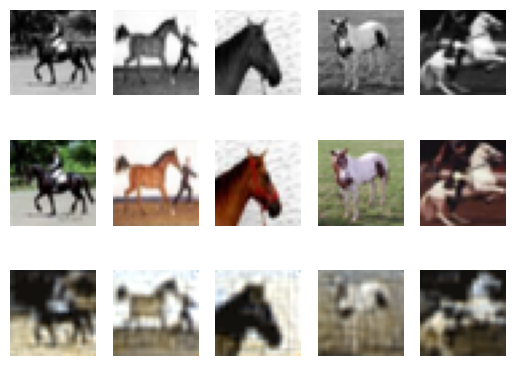

62 tensor(0.0065)


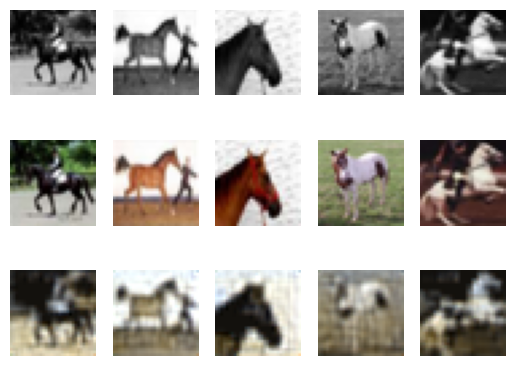

63 tensor(0.0065)


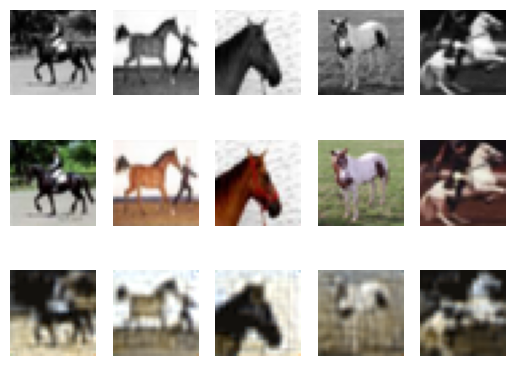

64 tensor(0.0065)


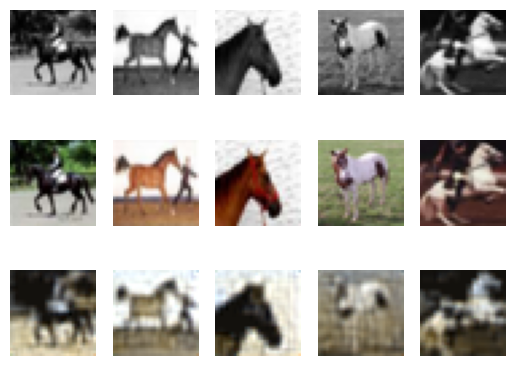

65 tensor(0.0064)


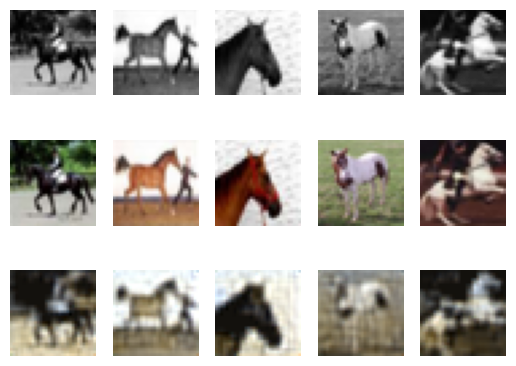

66 tensor(0.0064)


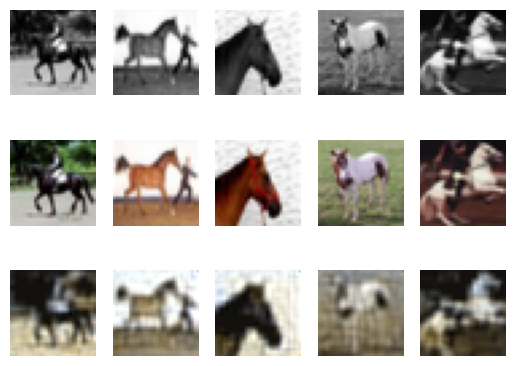

67 tensor(0.0064)


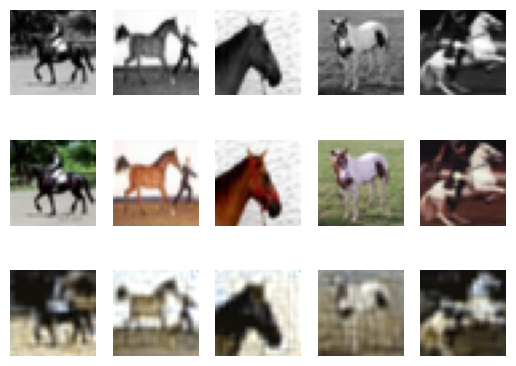

68 tensor(0.0064)


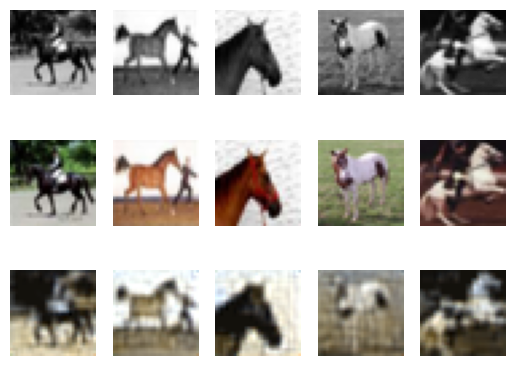

69 tensor(0.0063)


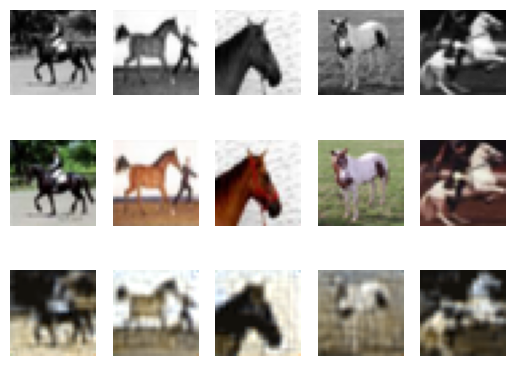

70 tensor(0.0063)


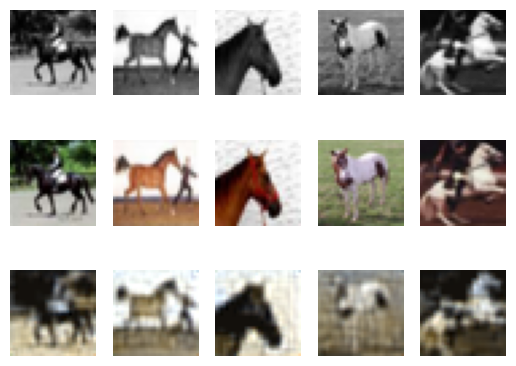

71 tensor(0.0063)


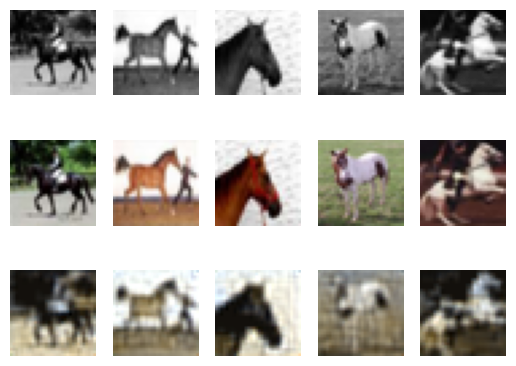

72 tensor(0.0063)


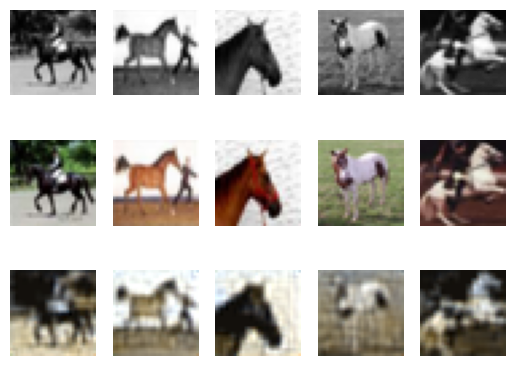

73 tensor(0.0062)


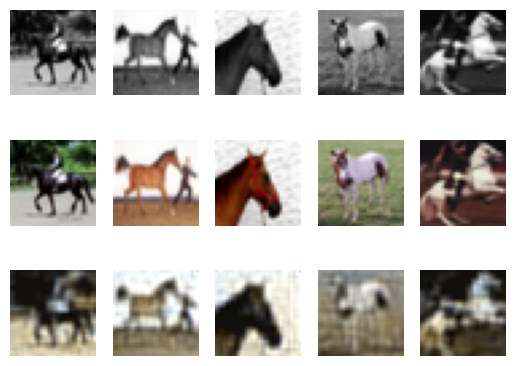

74 tensor(0.0062)


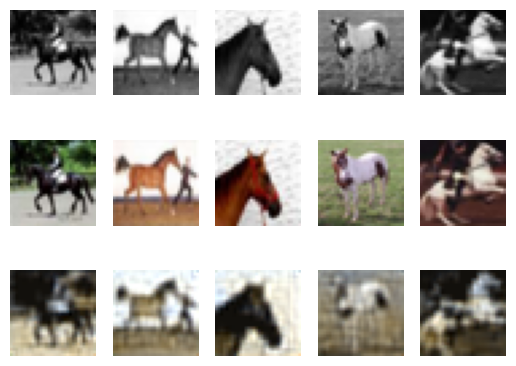

In [ ]:
#model 2: epoch = 75
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 100,
    "epochs": 75,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0464)


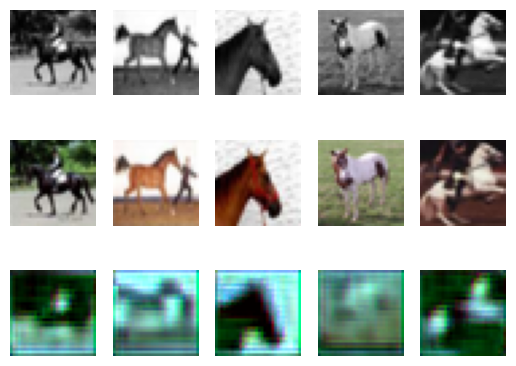

1 tensor(0.0190)


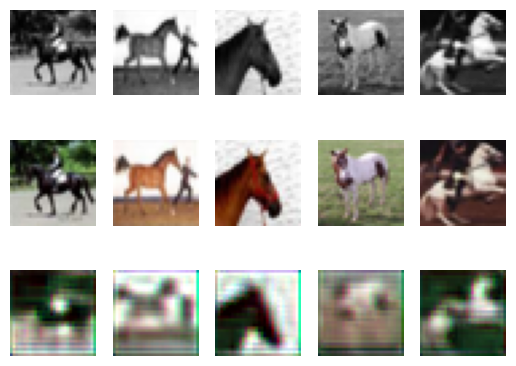

2 tensor(0.0155)


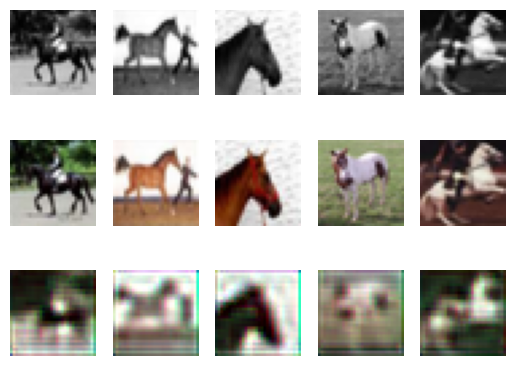

3 tensor(0.0141)


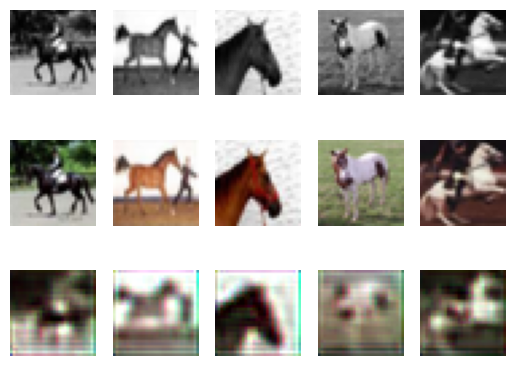

4 tensor(0.0133)


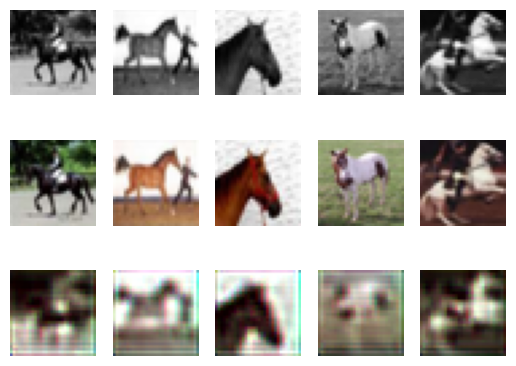

5 tensor(0.0127)


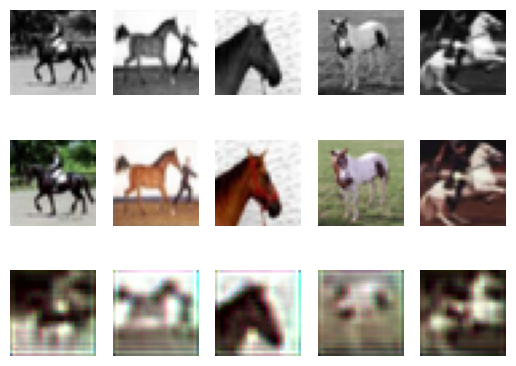

6 tensor(0.0122)


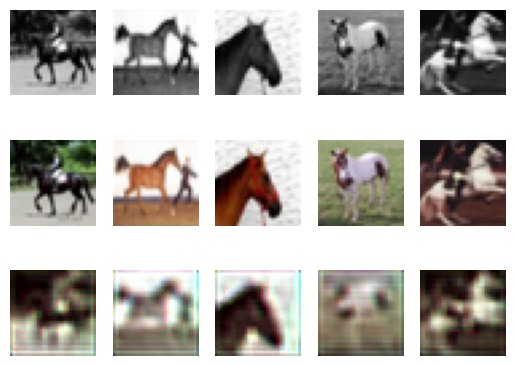

7 tensor(0.0118)


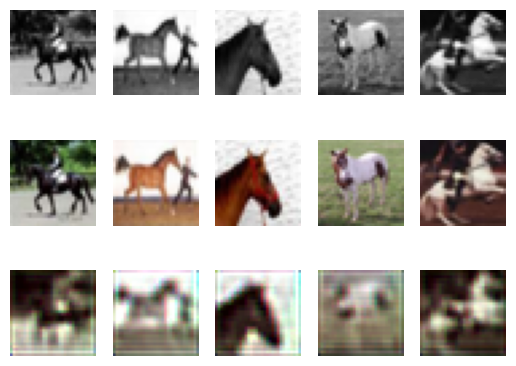

8 tensor(0.0114)


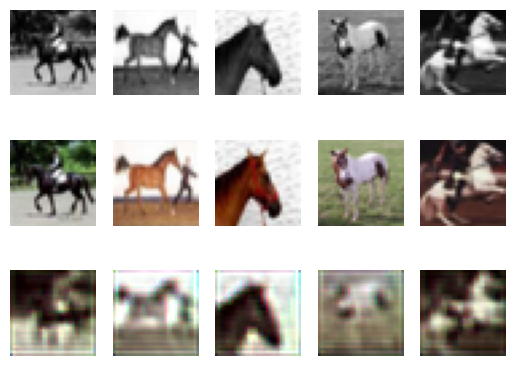

9 tensor(0.0111)


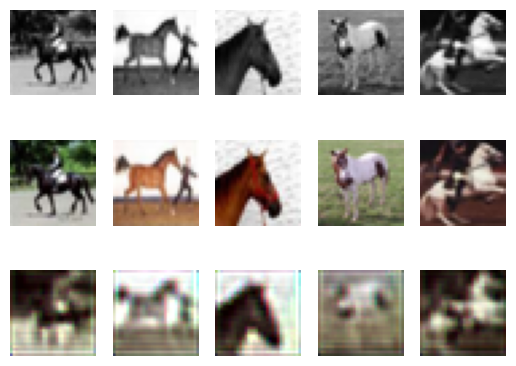

In [ ]:
#model 3: epoch = 10
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 100,
    "epochs": 10,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

In [ ]:
#model 4: epoch = 5
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 100,
    "epochs": 5,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

I retrained 4 new models with either increased or decreased number of epoch. As I increase the number of epochs, the loss improves and the final
loss with larger number of epoch is smaller than the final loss with small number of epoch. For example, final loss for epoch=75 is 0.0062 while final
loss for epoch=10 is 0.0111. As I increase the number of epochs, the output coloured images are more similar to the original images and more colours can
be seen. In conclusion, as number of epoch increases, loss and image quality improve.

### Part (iv)

Modify the convolutional neural network to include additional convolutional layers. Specifically, add an additional convolutional layer with the same number of filters as the previous layer and the same kernel size. Ensure that the appropriate parameters are modified (e.g. input and output channels, padding) to accommodate this change.

In [ ]:
class RegressionCNN_new(nn.Module):
    def __init__(self, kernel, num_filters):
        # first call parent's initialization function
        super().__init__()
        padding = kernel // 2

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.MaxPool2d(2))
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.MaxPool2d(2))

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU())

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.Upsample(scale_factor=2))

        self.conv_new = nn.Conv2d(num_filters, num_filters, kernel_size=kernel, padding=padding) #add additional convolutional layer

        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters, 3, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(3),
            nn.ReLU(),
            nn.Upsample(scale_factor=2))
        self.finalconv = nn.Conv2d(3, 3, kernel_size=kernel, padding=padding)

    def forward(self, x):
        out = self.downconv1(x)
        out = self.downconv2(out)
        out = self.rfconv(out)
        out = self.upconv1(out)
        out = self.conv_new(out) #add additional convolutional layer
        out = self.upconv2(out)
        out = self.finalconv(out)
        return out